# Лабораторная работа 3. Индексы

In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from PIL import Image

from glob import glob
import os
from pprint import pprint
import random

import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
nltk.download('stopwords')

# для лемматизации
import pymorphy3

[nltk_data] Downloading package punkt to /Users/a1/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/a1/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
ls ./res/embeddings

embeddings_metadata.csv    multimodal_embeddings.pkl
fusion_embeddings.pkl      tfidf_vectorizer.pkl
image_embeddings.csv


- Inverted Indexes: Suitable for text-based searches where you maintain a mapping of terms to documents.
- Graph-based Indexing: Useful when dealing with relationships between entities.
- Spatial Indexing: Effective for searching based on spatial attributes, such as location or similarity.

In [4]:
metadata = pd.read_csv('res/embeddings/embeddings_metadata.csv')

In [5]:
metadata

,Unnamed: 0,id,product_title,product_description,filename,format,mode,resolution,filesize,retrieved,merged_text
0,0,209650955,Триммер садовый электрический для травы,Модель беспроводной; аккумуляторный; ручной Ти...,res/img/209650955.png,PNG,RGBA,"(246, 328)",171.35,1.711019e+09,триммер садовый электрический для трава модель...
1,1,77278318,Триммер аккумуляторный садовый дачный кусторез,Модель разборная модель Питание Аккумулятор (в...,res/img/77278318.png,PNG,RGBA,"(246, 328)",160.00,1.711020e+09,триммер аккумуляторный садовый дачный кусторез...
2,2,18565737,Триммер аккумуляторный ZITREK GreenCut 20 (20В...,Модель GreenCut 20 Гарантийный срок 1 год Тип ...,res/img/18565737.png,PNG,RGBA,"(246, 328)",17.67,1.711020e+09,триммер аккумуляторный zitrek greencut 20 ( 20...
3,3,113066515,Триммер аккумуляторный садовый дачный кусторез,Модель разборная модель Питание Аккумулятор (в...,res/img/113066515.png,PNG,RGBA,"(246, 328)",128.90,1.711020e+09,триммер аккумуляторный садовый дачный кусторез...
4,4,151530782,Триммер-газонокосилка аккумуляторный ZITREK Gr...,Модель GreenCut 20 Pro Гарантийный срок 1 год ...,res/img/151530782.png,PNG,RGBA,"(246, 328)",128.13,1.711020e+09,триммергазонокосилка аккумуляторный zitrek gre...
...,...,...,...,...,...,...,...,...,...,...,...
222,222,32788767,Триммер садовый ЭТ-20-2ЛИ,Модель РЕСАНТА ЭТ-20-2ЛИ Гарантийный срок 1 го...,res/img/32788767.png,PNG,RGBA,"(246, 328)",163.56,1.711022e+09,триммер садовый эт202ть модель ресант эт202ть ...
223,223,36485887,"Ремень для триммера, бензокосы ранцевый",Материал изделия металл; пластик; непроницаемы...,res/img/36485887.png,PNG,RGBA,"(246, 328)",58.48,1.711022e+09,"ремень для триммер , бензокос ранцевый материа..."
224,224,32790048,"Триммер садовый ЭТ-600, 600Вт, ширина - 320мм",Гарантийный срок 1 Питание от сети 220 Вольт М...,res/img/32790048.png,PNG,RGBA,"(246, 328)",165.97,1.711022e+09,"триммер садовый эт600 , 600вт , ширина 320мма ..."
225,225,111124662,Леска для триммера звезда 3 мм катушка 144 метра,Длина (м) 19 м Сечение корда звезда Толщина ни...,res/img/111124662.png,PNG,RGBA,"(246, 328)",99.52,1.711022e+09,леска для триммер звезда 3 мм катушка 144 метр...


In [6]:
def preprocess_text(text):
    """ Извлечение слов из документа """
    # для лемматизации
    morph = pymorphy3.MorphAnalyzer()

    # определим русские стоп-слова
    russian_stopwords = stopwords.words("russian")

    # разделяем текст на отдельные слова, приводим к нижнему регистру
    text_tokens = word_tokenize(text.lower(), language="russian")

    # удаляем стоп-слова и знаки пунктуации
    tokens_without_sw = [word for word in text_tokens if word not in russian_stopwords and word.isalpha()]

    # приводим слова в нормальную форму
    words = list(set([morph.parse(token)[0].normal_form for token in tokens_without_sw]))

    return words

# Прямые индексы

In [7]:
class RegularIndex:
    def __init__(self):
        self.index = {}

    def add_document(self, doc_id, text):
        # Tokenize and process the text
        preprocessed_text = preprocess_text(text)  # Tokenize and convert to lowercase for simplicity
        self.index[doc_id] = preprocessed_text

    def search(self, query):
        query_terms = preprocess_text(query)
        result = set()

        # Find documents containing any of the query terms
        for term in query_terms:
            if term in self.index:
                result.update(self.index[term])

        return result

regular_index = RegularIndex()

In [8]:
for idx, row in metadata.iterrows():
    regular_index.add_document(row['id'], row['product_title'])

In [9]:
search_results = regular_index.search('Леска для косы')

In [10]:
len(search_results)

0

In [11]:
regular_index.index

{209650955: ['электрический', 'триммер', 'трава', 'садовый'],
 77278318: ['триммер', 'дачный', 'аккумуляторный', 'садовый', 'кусторез'],
 18565737: ['greencut', 'триммер', 'аккумуляторный', 'акб', 'zitrek'],
 113066515: ['триммер', 'дачный', 'аккумуляторный', 'садовый', 'кусторез'],
 151530782: ['аккумуляторный', 'greencut', 'pro', 'zitrek'],
 164885226: ['мощный',
  'триммер',
  'аккумуляторный',
  'трава',
  'садовый',
  'ручной'],
 208141196: ['триммер', 'садовый'],
 145821973: ['триммер', 'звезда', 'леска'],
 81408162: ['леска', 'триммер', 'катушка'],
 202528239: ['садовый', 'аккумуляторный', 'триммер', 'кусторез'],
 209801388: ['аккумуляторный', 'триммер', 'трава', 'садовый'],
 145821971: ['квадрат', 'триммер', 'м', 'мм', 'леска'],
 166091882: ['мощный',
  'триммер',
  'аккумуляторный',
  'трава',
  'садовый',
  'ручной'],
 208929943: ['леска', 'триммер', 'садовый', 'катушка'],
 156114215: ['набор', 'аккумуляторный', 'инструмент', 'zitrek'],
 210307736: ['бензиновый', 'триммер', '

In [12]:
index = {}
for idx, row in metadata.iterrows():
    wb_id = row['id']
    text = row['product_title']
    preprocessed_text = preprocess_text(text)
    index[wb_id] = preprocessed_text

print(index)

{209650955: ['электрический', 'триммер', 'трава', 'садовый'], 77278318: ['триммер', 'дачный', 'аккумуляторный', 'садовый', 'кусторез'], 18565737: ['greencut', 'триммер', 'аккумуляторный', 'акб', 'zitrek'], 113066515: ['триммер', 'дачный', 'аккумуляторный', 'садовый', 'кусторез'], 151530782: ['аккумуляторный', 'greencut', 'pro', 'zitrek'], 164885226: ['мощный', 'триммер', 'аккумуляторный', 'трава', 'садовый', 'ручной'], 208141196: ['триммер', 'садовый'], 145821973: ['триммер', 'звезда', 'леска'], 81408162: ['леска', 'триммер', 'катушка'], 202528239: ['садовый', 'аккумуляторный', 'триммер', 'кусторез'], 209801388: ['аккумуляторный', 'триммер', 'трава', 'садовый'], 145821971: ['квадрат', 'триммер', 'м', 'мм', 'леска'], 166091882: ['мощный', 'триммер', 'аккумуляторный', 'трава', 'садовый', 'ручной'], 208929943: ['леска', 'триммер', 'садовый', 'катушка'], 156114215: ['набор', 'аккумуляторный', 'инструмент', 'zitrek'], 210307736: ['бензиновый', 'триммер', 'электрический', 'насадка'], 1517236

# Inverted Indexes

Создаем обратные индексы.

In [13]:
class InvertedIndex:
    def __init__(self):
        self.index = {}

    def add_document(self, doc_id, text):
        # Tokenize and process the text
        terms = preprocess_text(text)  # Tokenize and convert to lowercase for simplicity

        # Update the inverted index for each term
        for position, term in enumerate(terms):
            if term not in self.index:
                self.index[term] = []
            self.index[term].append((doc_id, position))  # Store document ID and term position

    def search(self, query):
        query_terms = preprocess_text(query)
        result = set()

        # Find documents containing all query terms
        for term in query_terms:
            if term in self.index:
                result.update(self.index[term])

        return result
 



inverted_index = InvertedIndex()

In [14]:
for idx, row in metadata.iterrows():
    inverted_index.add_document(row['id'], row['product_title'])

-------------

Начинается дачный сезон, нужно привести участок в порядок. 
Попытаемся найти "Леску для косы"

---------------

In [15]:
search_query = 'Леска для косы'
search_results = inverted_index.search(search_query)

In [16]:
len(search_results)

74

In [17]:
for search_result in search_results:
    print(search_result[0])

158018340
159140094
90489650
28882459
159095624
25573651
111124662
153270175
208929943
137599333
83816649
169000377
147019572
162040797
79953744
209738848
163834853
162645823
58438067
27127852
108760154
81408162
83254734
145821990
113173192
158256245
211780093
81724469
137598695
137697828
81316383
152645052
83399827
161310101
79625604
158473391
33614143
81727495
76566433
161389798
83815761
165699185
28881812
160929462
148516227
87127420
153017312
172224272
83965255
95907911
39871204
148686467
76572141
37019144
172221094
57926908
145821973
162040798
137697202
79099267
81540326
164844986
156667550
22901699
142224421
28680567
213109941
210928422
209741520
32789388
154251555
145821971
76376997
158533040


In [18]:
def display_search_query(search_results, original_data):
    print(f'Search query: {search_query}')
    num_results = len(search_results)
    num_rows = (num_results + 4) // 5 
    fig, axs = plt.subplots(num_rows, 5, figsize = (20, 6 * num_rows))
    axs = axs.flatten()
    for i, search_result in enumerate(search_results):
        image = Image.open(metadata[metadata['id'] == search_result[0]]['filename'].values[0])
        axs[i].imshow(image)
        axs[i].axis('off')
        image.close()
        
    for i in range(num_results, num_rows * 5):
        fig.delaxes(axs[i])
        
    plt.tight_layout()
    plt.show()

Search query: Леска для косы


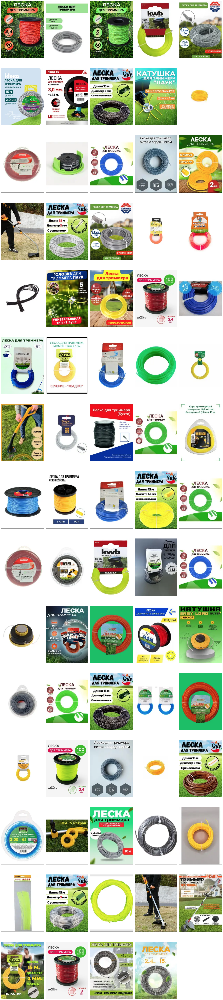

In [19]:
display_search_query(search_results, metadata)

Итак, леску нашли, осталось найти подходящий триммер

In [20]:
query = "Бензокоса"

Создаем также словарь, в которой будем хранить результаты поиска для дальнейшей оценки

In [34]:
results_dict = {
    'query' : query,
    'rank' : 1,
    'method' : 'FAISS + L2',
    'text' : 'Бензотриммер Patriot 1900',
    'image_path' : 'path/to/image.png',
    'distance' : 1.309
}

results_df = pd.DataFrame.from_dict(results_dict)

ValueError: If using all scalar values, you must pass an index

In [33]:
results_df

,query,rank,method,text,image_path,distance


# FAISS

In [21]:
!pip install faiss-cpu

In [22]:
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
import faiss

# Sample documents
documents = metadata[['id', 'product_title', 'filename']]

# Convert text data into TF-IDF vectors
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(documents['product_title'])
vectors = tfidf_matrix.toarray()


In [23]:
def search_with_images(query, k=5):
    query_vector = vectorizer.transform([query]).toarray()
    D, I = index.search(query_vector.astype(np.float32), k)
    
    results = []
    for d, i in zip(D[0], I[0]):
        document_text = documents.iloc[i]['product_title']
        image_path = documents.iloc[i]['filename']
        image = Image.open(image_path)
        results.append((document_text, image, d))
    
    return results

## Разные методы в FAISS

### L2

In [24]:
# Indexing with Faiss
d = vectors.shape[1]  # Dimension of vectors
index = faiss.IndexFlatL2(d)  # L2 distance 
index.add(vectors.astype(np.float32))

Text: Триммер бензиновый садовый бензокоса для травы TR-2500T
Distance: 1.0978457


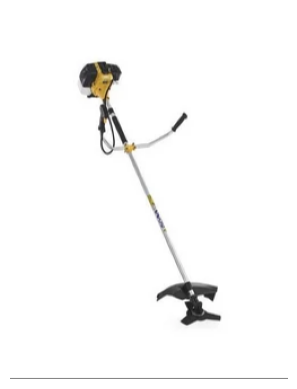

Text: Триммер бензиновый садовый бензокоса косилка Бтр-1900П
Distance: 1.1094497


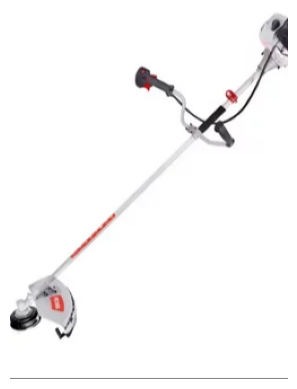

Text: Триммер бензиновый садовый бензокоса косилка Бтр2500П Проф
Distance: 1.1346004


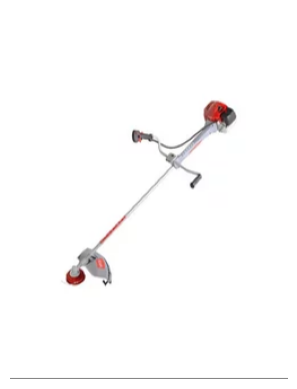

Text: Триммер бензиновый садовый бензокоса косилка КС-1800Р
Distance: 1.1498364


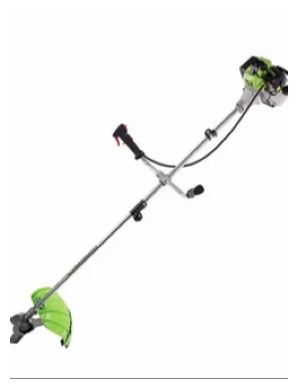

Text: Нож металлический для триммера садового. 4 лезвия, 4-х
Distance: 1.9999998


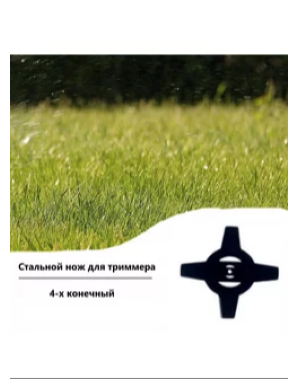

In [25]:

results = search_with_images(query)
for document_text, image, distance in results:
    print("Text:", document_text)
    print("Distance:", distance)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

### Inner Product

In [26]:
# Indexing with Faiss
d = vectors.shape[1]  # Dimension of vectors
index = faiss.IndexFlatIP(d)  # Inner product  
index.add(vectors.astype(np.float32))

Text: Триммер бензиновый садовый бензокоса для травы TR-2500T
Distance: 0.45107716


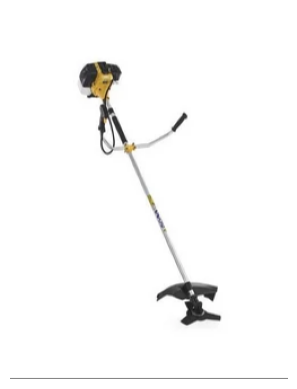

Text: Триммер бензиновый садовый бензокоса косилка Бтр-1900П
Distance: 0.44527513


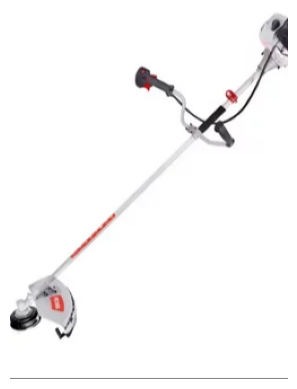

Text: Триммер бензиновый садовый бензокоса косилка Бтр2500П Проф
Distance: 0.43269983


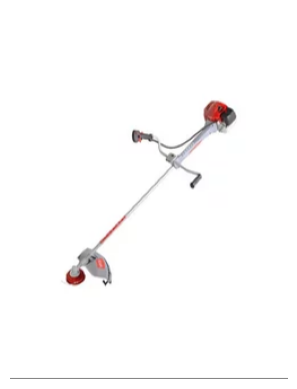

Text: Триммер бензиновый садовый бензокоса косилка КС-1800Р
Distance: 0.42508176


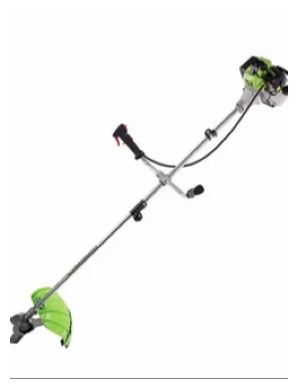

Text: Триммер-газонокосилка аккумуляторный ZITREK GreenCut 20 Pro
Distance: 0.0


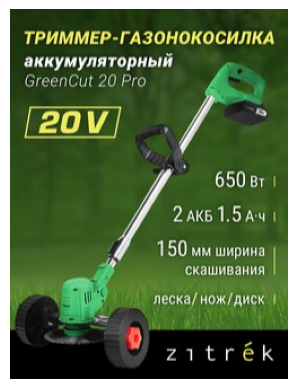

In [27]:

results = search_with_images(query)
for document_text, image, distance in results:
    print("Text:", document_text)
    print("Distance:", distance)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

Пробовал еще IndexHNSWFlat, IndexFlatIP, по каким-то причинам крашится ядро. 

# Annoy

In [28]:
!pip install annoy

## Annoy metrics

### Angular

Text: Триммер бензиновый садовый бензокоса для травы TR-2500T
Distance: 1.0477813482284546


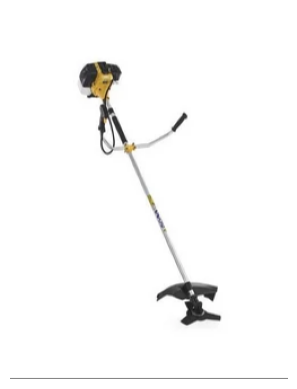

Text: Триммер бензиновый садовый бензокоса косилка Бтр-1900П
Distance: 1.0533041954040527


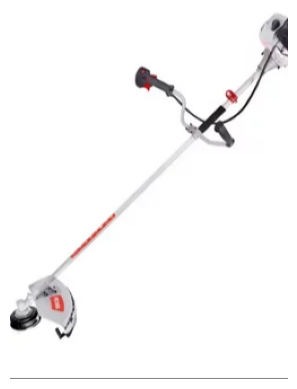

Text: Триммер бензиновый садовый бензокоса косилка Бтр2500П Проф
Distance: 1.065176248550415


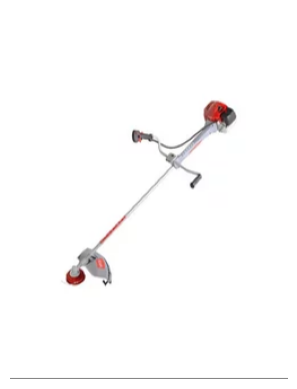

Text: Триммер бензиновый садовый бензокоса косилка КС-1800Р
Distance: 1.072304368019104


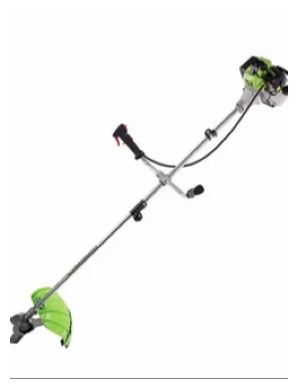

Text: Триммер садовый электрический для травы
Distance: 1.4142135381698608


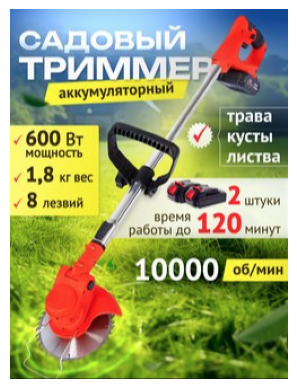

In [29]:
from annoy import AnnoyIndex
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer

def search_with_images(query, k=5):
    query_vector = vectorizer.transform([query]).toarray()[0]
    indices, distances = annoy_index.get_nns_by_vector(query_vector, k, include_distances=True)
    results = []
    for idx, dist in zip(indices, distances):
        document = documents.iloc[idx, :]
        document_text = document["product_title"]
        image_path = document["filename"]
        results.append((document_text, image_path, dist))
    return results

# Convert text data into TF-IDF vectors
corpus = documents['product_title']
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(corpus)
vectors = tfidf_matrix.toarray()

# Indexing with Annoy
dimension = vectors.shape[1]  # Dimension of vectors
num_trees = 10
annoy_index = AnnoyIndex(dimension, 'angular')  # Angular distance is commonly used
for i, vector in enumerate(vectors):
    annoy_index.add_item(i, vector)
annoy_index.build(num_trees)


# Performing search

results = search_with_images(query)
for document_text, image_path, distance in results:
    print("Text:", document_text)
    print("Distance:", distance)
    image = Image.open(image_path)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

### Euclidean

Text: Триммер бензиновый садовый бензокоса для травы TR-2500T
Distance: 1.0477813482284546


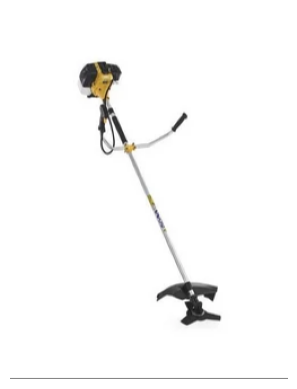

Text: Триммер бензиновый садовый бензокоса косилка Бтр-1900П
Distance: 1.0533041954040527


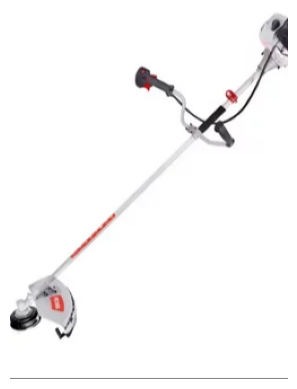

Text: Триммер бензиновый садовый бензокоса косилка Бтр2500П Проф
Distance: 1.0651761293411255


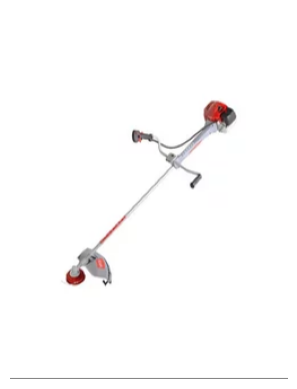

Text: Триммер бензиновый садовый бензокоса косилка КС-1800Р
Distance: 1.072304368019104


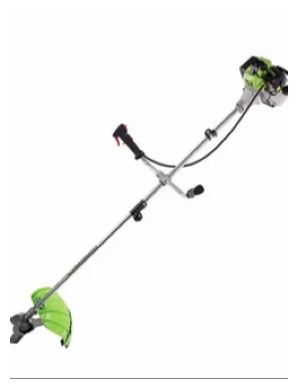

Text: Леска для катушки триммера 2.4 мм звезда
Distance: 1.4142134189605713


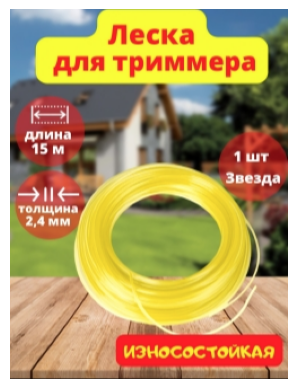

In [30]:
# Indexing with Annoy
dimension = vectors.shape[1]  # Dimension of vectors
num_trees = 10
annoy_index = AnnoyIndex(dimension, 'euclidean')  # Angular distance is commonly used
for i, vector in enumerate(vectors):
    annoy_index.add_item(i, vector)
annoy_index.build(num_trees)


# Performing search

results = search_with_images(query)
for document_text, image_path, distance in results:
    print("Text:", document_text)
    print("Distance:", distance)
    image = Image.open(image_path)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

### Manhattan

Text: Леска триммерная
Distance: 2.3663337230682373


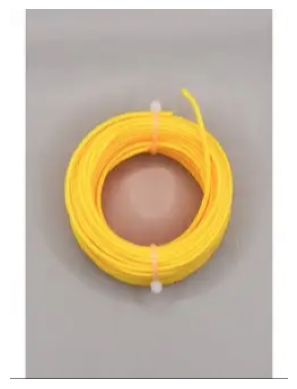

Text: Триммер бензиновый
Distance: 2.3851377964019775


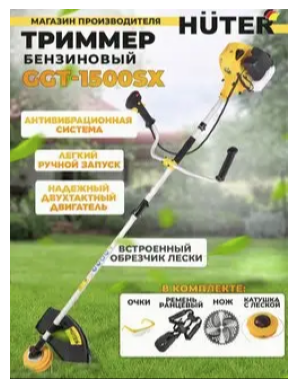

Text: Триммер садовый
Distance: 2.4021031856536865


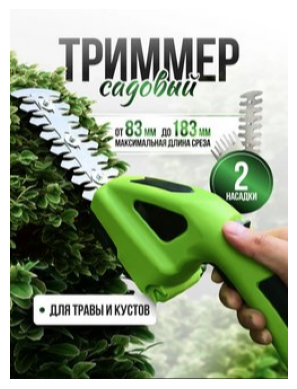

Text: Триммер садовый
Distance: 2.4021031856536865


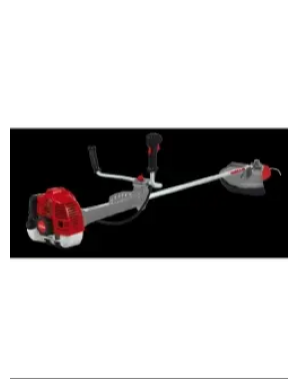

Text: Триммер колесный бензиновый
Distance: 2.555771827697754


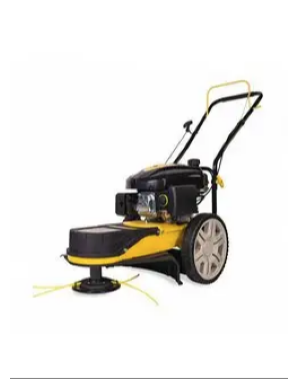

In [31]:
# Indexing with Annoy
dimension = vectors.shape[1]  # Dimension of vectors
num_trees = 10
annoy_index = AnnoyIndex(dimension, 'manhattan')  # Angular distance is commonly used
for i, vector in enumerate(vectors):
    annoy_index.add_item(i, vector)
annoy_index.build(num_trees)


# Performing search

results = search_with_images(query)
for document_text, image_path, distance in results:
    print("Text:", document_text)
    print("Distance:", distance)
    image = Image.open(image_path)
    plt.imshow(image)
    plt.axis('off')
    plt.show()